# Churn prediction

In [1]:
import os
import mlflow
import pandas as pd
from databricks import sql
mlflow.set_tracking_uri("http://host.docker.internal:5000")

In [2]:
database = "olist_dataset"
goldSche=database+ ".gold"
lookupGeo=database+".silver"+ ".silver_olist_geolocation"
lookupCateName=database+".silver"+ ".silver_product_category_name_translation"


In [3]:

connection = sql.connect(
                        server_hostname = "dbc-214ffec4-c1f2.cloud.databricks.com",
                        http_path = "/sql/1.0/warehouses/8753fa7395d762fe",
                        access_token = os.environ.get("DATABRICKS_TOKEN"))




In [4]:
df = pd.read_sql(
    f""" SELECT 
        o.order_key,
        o.order_id,
        oi.customer_key,
        d_purchase.full_date AS purchase_date,
        d_delivered.full_date AS delivered_date,
        
        -- === TÍNH TOÁN CÁC FEATURE MỚI  ===
        
        -- 1. Số ngày giao trễ so với dự kiến
        DATEDIFF(day, d_estimated.full_date, d_delivered.full_date) AS delivery_overdue_days,

        -- 2. Cờ đánh dấu đơn hàng giao trễ (1 = trễ, 0 = không trễ)
        CASE 
            WHEN d_delivered.full_date > d_estimated.full_date THEN 1 
            ELSE 0 
        END AS is_delivered_late,

        -- 3. Thời gian xử lý nội bộ (từ lúc duyệt đến lúc giao vận chuyển)
        DATEDIFF(day, d_approved.full_date, d_carrier.full_date) AS internal_processing_days,

        -- 4. Thời gian giao hàng hứa hẹn (từ lúc mua đến ngày giao dự kiến)
        DATEDIFF(day, d_purchase.full_date, d_estimated.full_date) AS promised_window_days,
        
        --5. Khách hàng mua hàng ở thời điểm là holiday
        d_purchase.is_holiday is_purchase_holiday

    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.fact_order_items oi ON oi.order_key = o.order_key
    
    -- Join với bảng Date nhiều lần cho mỗi loại ngày
    JOIN {goldSche}.dim_date d_purchase ON o.order_purchase_date_key = d_purchase.date_key
    LEFT JOIN {goldSche}.dim_date d_delivered ON o.order_delivered_customer_date_key = d_delivered.date_key
    LEFT JOIN {goldSche}.dim_date d_estimated ON o.order_estimated_delivery_date_key = d_estimated.date_key
    LEFT JOIN {goldSche}.dim_date d_approved ON o.order_approved_at_date_key = d_approved.date_key
    LEFT JOIN {goldSche}.dim_date d_carrier ON o.order_delivered_carrier_date_key = d_carrier.date_key

    WHERE o.order_status = 'delivered'
    -- GROUP BY để tránh trùng lặp nếu một đơn hàng có nhiều sản phẩm
    GROUP BY 1, 2, 3, 4, 5, 6, 7, 8, 9,10"""
    , connection)
df.head(20)

/tmp/ipykernel_6904/2197026316.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,order_key,order_id,customer_key,purchase_date,delivered_date,delivery_overdue_days,is_delivered_late,internal_processing_days,promised_window_days,is_purchase_holiday
0,5,00042b26cf59d7ce69dfabb4e55b4fd9,36735,2017-02-04,2017-03-01,-16.0,0,12.0,41,False
1,12,00063b381e2406b52ad429470734ebd5,23289,2018-07-27,2018-08-07,0.0,0,3.0,11,False
2,16,0009c9a17f916a706d71784483a5d643,35210,2018-04-25,2018-04-30,-9.0,0,2.0,14,False
3,27,0011d82c4b53e22e84023405fb467e57,1046,2018-01-16,2018-01-26,-20.0,0,7.0,30,False
4,30,0013503b13da1eac686219390b7d641b,7842,2017-12-05,2017-12-20,-8.0,0,0.0,23,False
5,36,00169e31ef4b29deaae414f9a5e95929,31946,2018-01-16,2018-01-23,-15.0,0,0.0,22,False
6,66,0029c5db35ef291ce99d1262012e7daa,65236,2018-08-25,2018-08-30,-4.0,0,1.0,9,False
7,80,0032d07457ae9c806c79368d7d9ce96b,55594,2018-03-10,2018-04-29,12.0,1,3.0,38,False
8,95,003a7f59d7e08a9c61d9e2881fe6459c,93745,2018-08-19,2018-08-27,-2.0,0,2.0,10,False
9,150,0068e836900867da359bd81db9227a33,90002,2017-09-29,2017-10-05,-19.0,0,0.0,25,False


#### Notes: 
Vì bộ data này được tạo khá lâu so với ngày hiện tại nên không thể tính recency dựa trên CURRENT_DATE, 
để xử lí việc này em mới tạo analysis snapshot cte để lấy làm ngày mốc.

In [5]:
query =f"""

WITH analysis_snapshot AS (
    SELECT 
        DATEADD(day, 1, MAX(d.full_date)) AS snapshot_date
    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.dim_date d ON o.order_purchase_date_key = d.date_key
),
--Lấy thông tin về ngày mua hàng và ngày giao hàng thành công cho mỗi đơn hàng.
 order_dates AS ( 
    SELECT 
        o.order_key,
        o.order_id,
        oi.customer_key,
        d_purchase.full_date AS purchase_date,
        d_delivered.full_date AS delivered_date,
        
        -- === TÍNH TOÁN CÁC FEATURE MỚI  ===
        
        -- 1. Số ngày giao trễ so với dự kiến 
        DATEDIFF(day, d_estimated.full_date, d_delivered.full_date) AS delivery_overdue_days,

        -- 2. Cờ đánh dấu đơn hàng giao trễ (1 = trễ, 0 = không trễ)
        CASE 
            WHEN d_delivered.full_date > d_estimated.full_date THEN 1 
            ELSE 0 
        END AS is_delivered_late,

        -- 3. Thời gian xử lý nội bộ (từ lúc duyệt đến lúc giao vận chuyển)
        DATEDIFF(day, d_approved.full_date, d_carrier.full_date) AS internal_processing_days,

        -- 4. Thời gian giao hàng hứa hẹn (từ lúc mua đến ngày giao dự kiến)
        DATEDIFF(day, d_purchase.full_date, d_estimated.full_date) AS promised_window_days,
        
        --5. Khách hàng mua hàng ở thời điểm là holiday
        d_purchase.is_holiday is_purchase_holiday

    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.fact_order_items oi ON oi.order_key = o.order_key
    
    -- Join với bảng Date nhiều lần cho mỗi loại ngày
    JOIN {goldSche}.dim_date d_purchase ON o.order_purchase_date_key = d_purchase.date_key
    LEFT JOIN {goldSche}.dim_date d_delivered ON o.order_delivered_customer_date_key = d_delivered.date_key
    LEFT JOIN {goldSche}.dim_date d_estimated ON o.order_estimated_delivery_date_key = d_estimated.date_key
    LEFT JOIN {goldSche}.dim_date d_approved ON o.order_approved_at_date_key = d_approved.date_key
    LEFT JOIN {goldSche}.dim_date d_carrier ON o.order_delivered_carrier_date_key = d_carrier.date_key

    WHERE o.order_status = 'delivered'
    -- GROUP BY để tránh trùng lặp nếu một đơn hàng có nhiều sản phẩm
    GROUP BY 1, 2, 3, 4, 5, 6, 7, 8, 9,10
),
-- Tính giá trị cho mỗi đơn hàng, và thông tin của chúng
order_values AS (
    SELECT  
            oi.customer_key,
            oi.order_key,
            SUM(oi.price) AS order_price,
            SUM(oi.freight_value) AS order_freight
        FROM {goldSche}.fact_order_items oi
        GROUP BY oi.customer_key, oi.order_key
),

customer_agg AS (
    SELECT 
        od.customer_key,
        -- Recency: ngày hiện tại - ngày mua cuối
        DATEDIFF(day, MAX(od.purchase_date), (SELECT snapshot_date FROM analysis_snapshot)) AS recency_days,
        -- Tenure: ngày mua gần nhất - ngày mua đầu tiên ( thời gian gắn bó)
        DATEDIFF(day, MIN(od.purchase_date), MAX(od.purchase_date)) AS customer_tenure,
        -- Frequency: số lượng đơn
        COUNT(DISTINCT od.order_id) AS frequency_orders,
        -- Monetary: tổng tiền chi tiêu
        SUM(ov.order_price) AS monetary_value,
        -- Average order value
        AVG(ov.order_price) AS avg_order_price,
        -- Tổng freight
        SUM(ov.order_freight) AS sum_freight,
        -- Avg freight
        AVG(ov.order_freight) AS avg_freight,


        -- Aggerate các cột về thời gian.
        AVG(DATEDIFF(day, od.purchase_date, od.delivered_date)) AS avg_delivery_delay,
        AVG(CAST(od.is_delivered_late AS FLOAT)) AS late_delivery_rate,
        AVG(od.delivery_overdue_days) AS avg_delivery_overdue_days,
        AVG(od.internal_processing_days) AS avg_internal_processing_days,
        AVG(od.promised_window_days) AS avg_promised_window_days,

        -- 1. Tỷ lệ mua hàng vào ngày lễ
        AVG(CASE WHEN od.is_purchase_holiday = true THEN 1.0 ELSE 0.0 END) AS holiday_purchase_rate,
        -- 2. Số ngày giao trễ trung bình, tính riêng cho ngày lễ và ngày thường
        AVG(CASE WHEN od.is_purchase_holiday = true THEN od.delivery_overdue_days END) AS avg_overdue_days_on_holidays,
        AVG(CASE WHEN od.is_purchase_holiday = false THEN od.delivery_overdue_days END) AS avg_overdue_days_on_non_holidays


    FROM order_dates od
    JOIN order_values ov ON od.order_key = ov.order_key
    GROUP BY od.customer_key
),

review_agg AS (
    SELECT 
        r.customer_key,
        AVG(r.score) AS avg_review_score
    FROM {goldSche}.fact_reviews r
    GROUP BY r.customer_key
),

payment_agg AS (
    SELECT 
        p.customer_key,
        COUNT(DISTINCT pt.payment_type) AS distinct_payment_methods,
        AVG(p.payment_installments) AS avg_installments
    FROM {goldSche}.fact_payments p
    JOIN {goldSche}.dim_olist_payment_type pt ON p.payment_type_key = pt.payment_type_key
    GROUP BY p.customer_key
)

SELECT 
    c.customer_key,
    ca.recency_days,
    ca.customer_tenure,
    ca.frequency_orders,
    ca.monetary_value,
    ca.avg_order_price,
    ca.sum_freight,
    ca.avg_freight,



    -- Các feature mới về thời gian và hiệu suất giao hàng
    ca.avg_delivery_delay,
    ca.late_delivery_rate,
    ca.avg_delivery_overdue_days,
    ca.avg_internal_processing_days,
    ca.avg_promised_window_days,

    -- Các feature mới về ngày lễ (holidays)
    ca.holiday_purchase_rate,
    ca.avg_overdue_days_on_holidays,
    ca.avg_overdue_days_on_non_holidays,


    -- Các feature từ CTE khác
    ra.avg_review_score,
    pa.distinct_payment_methods,
    pa.avg_installments,


    -- === THÊM CHURN LABEL  ===
    CASE 
        WHEN ca.recency_days > 180 THEN 1 
        ELSE 0 
    END AS churn_label
    
FROM customer_agg ca
LEFT JOIN review_agg ra ON ca.customer_key = ra.customer_key
LEFT JOIN payment_agg pa ON ca.customer_key = pa.customer_key
JOIN {goldSche}.dim_olist_customers c ON ca.customer_key = c.customer_key AND c.is_current=true;

"""
df=pd.read_sql(query ,connection)
df.head()

/tmp/ipykernel_6904/12001578.py:162: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df=pd.read_sql(query ,connection)


,customer_key,recency_days,customer_tenure,frequency_orders,monetary_value,avg_order_price,sum_freight,avg_freight,avg_delivery_delay,late_delivery_rate,avg_delivery_overdue_days,avg_internal_processing_days,avg_promised_window_days,holiday_purchase_rate,avg_overdue_days_on_holidays,avg_overdue_days_on_non_holidays,avg_review_score,distinct_payment_methods,avg_installments,churn_label
0,54383,78,0,1,22.5,22.5,18.26,18.26,9.0,0.0,-14.0,0.0,23.0,0.0,NaN,-14.0,5.0,1.0,1.0,0
1,45761,411,0,1,28.9,28.9,13.37,13.37,16.0,0.0,-3.0,2.0,19.0,0.0,NaN,-3.0,5.0,1.0,1.0,1
2,73174,351,0,1,69.9,69.9,16.25,16.25,13.0,0.0,-8.0,7.0,21.0,0.0,NaN,-8.0,1.0,1.0,2.0,1
3,28613,279,0,1,69.9,69.9,38.04,38.04,41.0,1.0,14.0,3.0,27.0,0.0,NaN,14.0,1.0,1.0,4.0,1
4,50738,471,0,1,89.9,89.9,24.94,24.94,8.0,0.0,-13.0,4.0,21.0,0.0,NaN,-13.0,4.0,1.0,1.0,1


In [6]:

connection.close()

In [7]:
df.describe()

,customer_key,recency_days,customer_tenure,frequency_orders,monetary_value,avg_order_price,sum_freight,avg_freight,avg_delivery_delay,late_delivery_rate,avg_delivery_overdue_days,avg_internal_processing_days,avg_promised_window_days,holiday_purchase_rate,avg_overdue_days_on_holidays,avg_overdue_days_on_non_holidays,avg_review_score,distinct_payment_methods,avg_installments,churn_label
count,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93098.000000,93106.000000,93098.000000,93091.000000,93106.000000,93106.000000,2455.000000,90747.000000,92503.000000,93105.000000,93105.000000,93106.000000
mean,47964.640120,287.594033,2.291904,1.030621,141.272944,137.521111,23.482897,22.777861,12.505978,0.068092,-11.847325,2.695660,24.353315,0.025776,-12.512492,-11.830933,4.152420,1.026304,2.897656,0.708826
std,27685.875628,152.641398,23.164587,0.199395,215.569458,210.054082,22.720806,21.465613,9.560611,0.250640,10.143273,3.537362,8.712098,0.157607,9.222444,10.166363,1.280842,0.161108,2.675080,0.454306
min,1.000000,50.000000,0.000000,1.000000,0.850000,0.850000,0.000000,0.000000,0.000000,0.000000,-147.000000,-171.000000,3.000000,0.000000,-53.000000,-147.000000,1.000000,1.000000,0.000000,0.000000
25%,23995.250000,164.000000,0.000000,1.000000,47.550000,45.990000,14.060000,13.870000,7.000000,0.000000,-17.000000,1.000000,19.000000,0.000000,-17.000000,-17.000000,4.000000,1.000000,1.000000,0.000000
50%,47980.500000,269.000000,0.000000,1.000000,89.220000,86.990000,17.600000,17.230000,10.000000,0.000000,-12.000000,2.000000,24.000000,0.000000,-13.000000,-12.000000,5.000000,1.000000,2.000000,1.000000
75%,71932.750000,396.000000,0.000000,1.000000,153.000000,149.900000,25.397500,24.090000,16.000000,0.000000,-7.000000,3.000000,29.000000,0.000000,-8.000000,-7.000000,5.000000,1.000000,4.000000,1.000000
max,96096.000000,763.000000,633.000000,15.000000,13440.000000,13440.000000,1794.960000,1794.960000,210.000000,1.000000,188.000000,126.000000,156.000000,1.000000,69.000000,188.000000,5.000000,3.000000,24.000000,1.000000


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93106 entries, 0 to 93105
Data columns (total 20 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   customer_key                      93106 non-null  int64  
 1   recency_days                      93106 non-null  int64  
 2   customer_tenure                   93106 non-null  int64  
 3   frequency_orders                  93106 non-null  int64  
 4   monetary_value                    93106 non-null  float64
 5   avg_order_price                   93106 non-null  float64
 6   sum_freight                       93106 non-null  float64
 7   avg_freight                       93106 non-null  float64
 8   avg_delivery_delay                93098 non-null  float64
 9   late_delivery_rate                93106 non-null  float64
 10  avg_delivery_overdue_days         93098 non-null  float64
 11  avg_internal_processing_days      93091 non-null  float64
 12  avg_

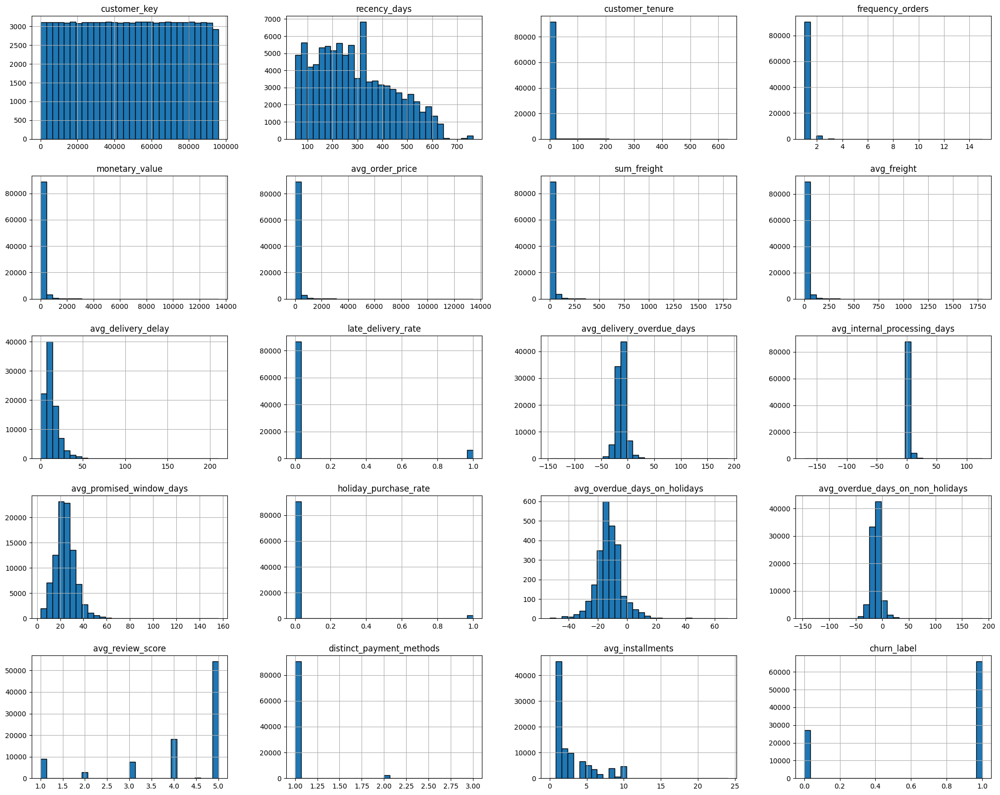

In [9]:
df.hist(figsize=(25, 20), bins=30, edgecolor='black');

In [10]:
from ydata_profiling import ProfileReport
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 20/20 [00:00<00:00, 46.25it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

--- Xử lý dữ liệu bị thiếu ---
Cột 'avg_overdue_days_on_holidays' đã được điền giá trị 0.
Cột 'avg_delivery_delay' đã được điền giá trị trung vị: 10.0
Cột 'avg_delivery_overdue_days' đã được điền giá trị trung vị: -12.0
Cột 'avg_internal_processing_days' đã được điền giá trị trung vị: 2.0
Cột 'avg_review_score' đã được điền giá trị trung vị: 5.0
Cột 'distinct_payment_methods' đã được điền giá trị trung vị: 1.0
Cột 'avg_installments' đã được điền giá trị trung vị: 2.0
Cột 'avg_overdue_days_on_non_holidays' đã được điền giá trị trung vị: -12.0

Kiểm tra lại dữ liệu thiếu sau khi xử lý:
customer_key                        0
recency_days                        0
customer_tenure                     0
frequency_orders                    0
monetary_value                      0
avg_order_price                     0
sum_freight                         0
avg_freight                         0
avg_delivery_delay                  0
late_delivery_rate                  0
avg_delivery_overdue_days    

/tmp/ipykernel_6904/4188094772.py:10: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['avg_overdue_days_on_holidays'].fillna(0, inplace=True)
/tmp/ipykernel_6904/4188094772.py:25: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=

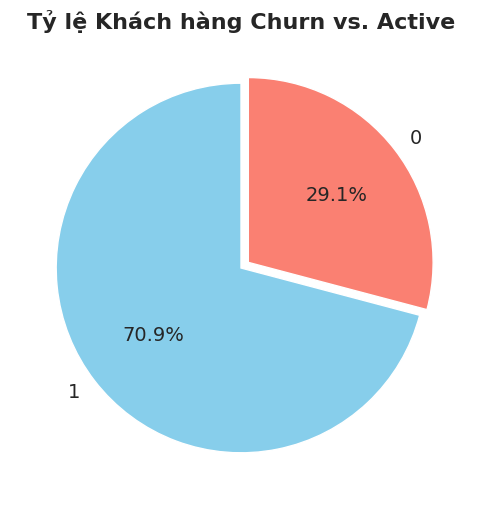


--- Phân tích các Feature chính ---


/tmp/ipykernel_6904/4188094772.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


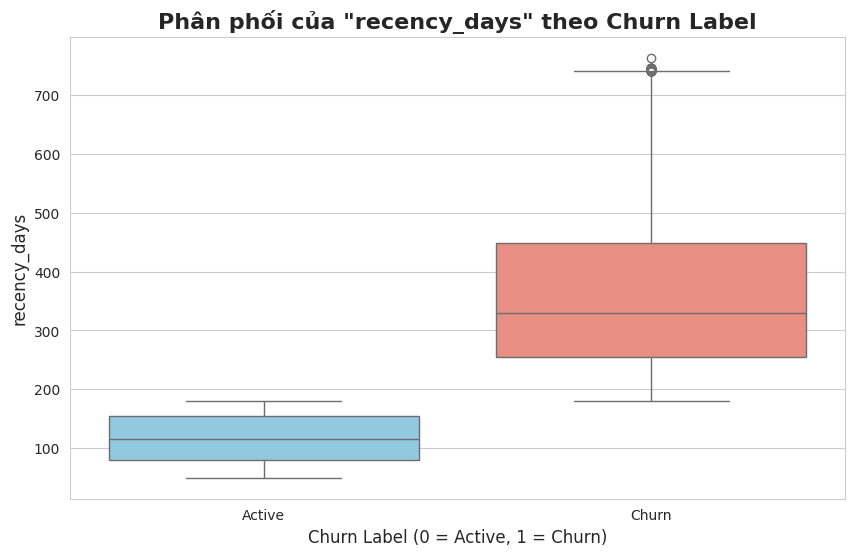

/tmp/ipykernel_6904/4188094772.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


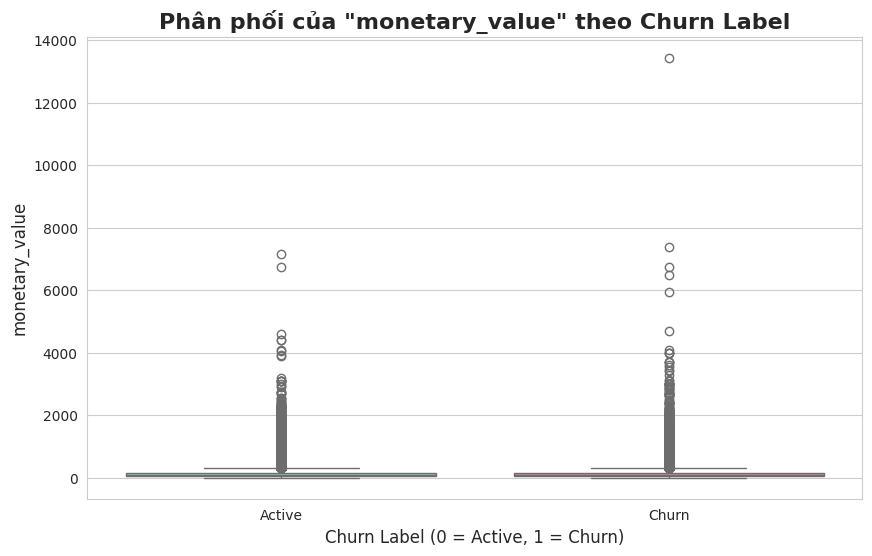

/tmp/ipykernel_6904/4188094772.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


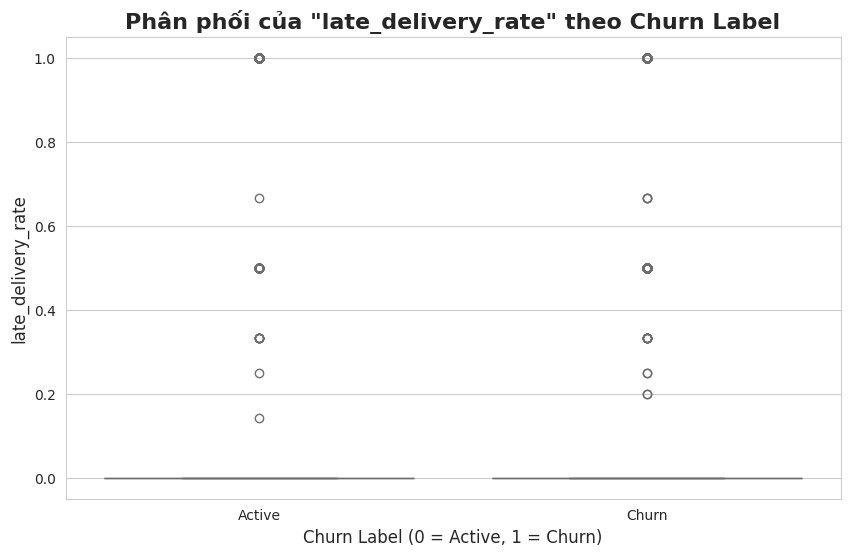

/tmp/ipykernel_6904/4188094772.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


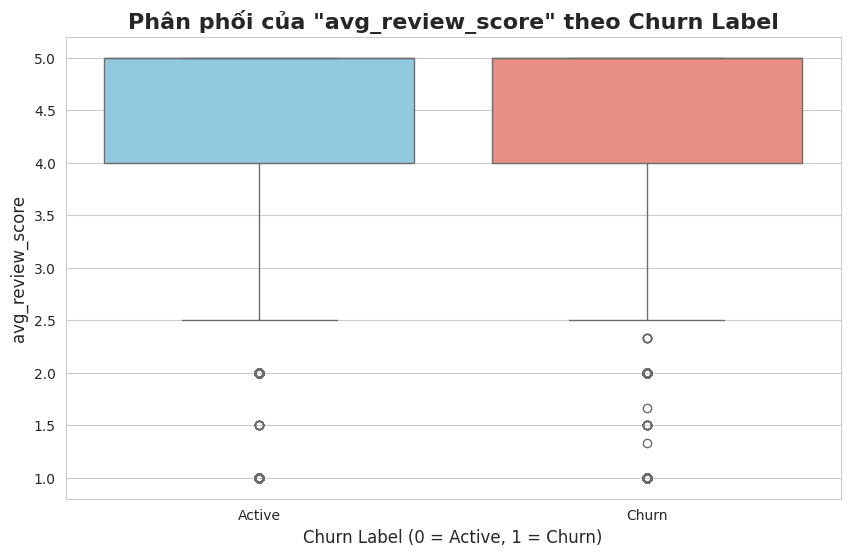

/tmp/ipykernel_6904/4188094772.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


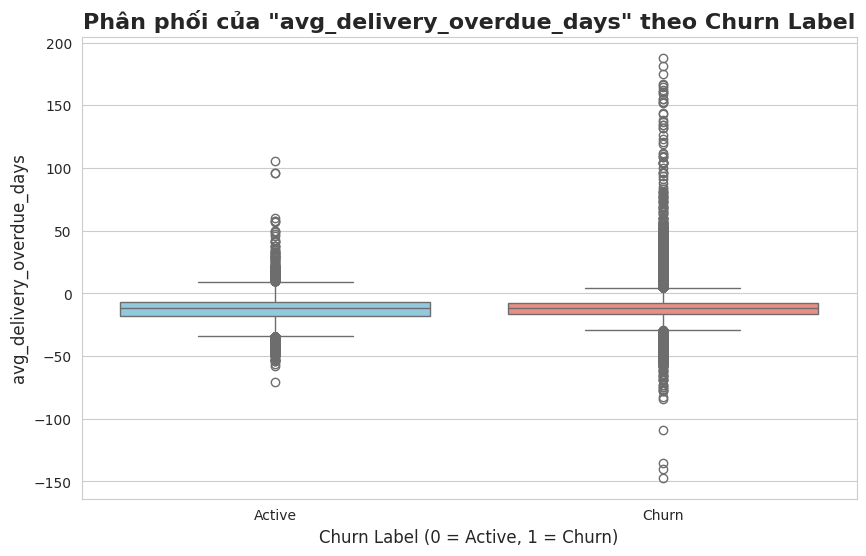

/tmp/ipykernel_6904/4188094772.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


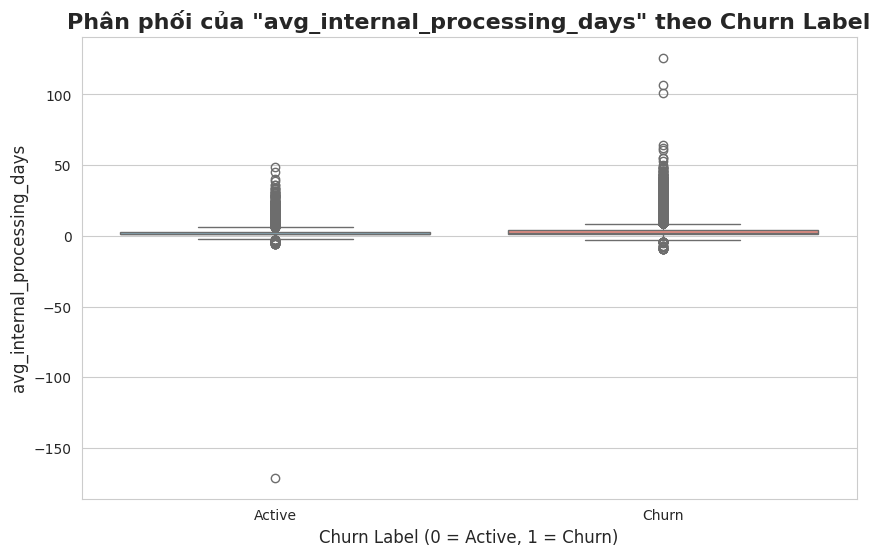

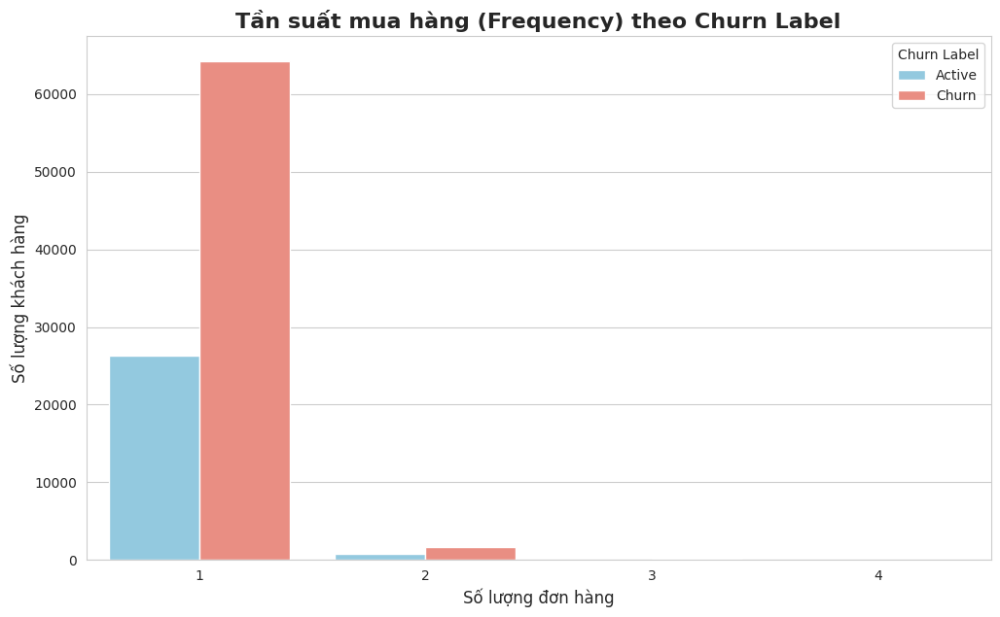

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns



# --- Phần 1: Xử lý dữ liệu bị thiếu (Data Cleaning) ---
print("--- Xử lý dữ liệu bị thiếu ---")

# Xử lý cột có nhiều giá trị thiếu: thay thế null bằng 0
df['avg_overdue_days_on_holidays'].fillna(0, inplace=True)
print("Cột 'avg_overdue_days_on_holidays' đã được điền giá trị 0.")

# Lấy danh sách các cột còn lại cần điền giá trị
cols_to_fill_median = [
    'avg_delivery_delay', 'avg_delivery_overdue_days', 
    'avg_internal_processing_days', 'avg_review_score', 
    'distinct_payment_methods', 'avg_installments',
    'avg_overdue_days_on_non_holidays'
]

# Dùng vòng lặp để điền giá trị trung vị (median)
for col in cols_to_fill_median:
    if df[col].isnull().any():
        median_val = df[col].median()
        df[col].fillna(median_val, inplace=True)
        print(f"Cột '{col}' đã được điền giá trị trung vị: {median_val}")

print("\nKiểm tra lại dữ liệu thiếu sau khi xử lý:")
print(df.isnull().sum())
print("-" * 30)


# --- Phần 2: Phân tích biến mục tiêu (Churn Label) ---
print("\n--- Phân tích biến mục tiêu ---")
churn_rate = df['churn_label'].value_counts(normalize=True) * 100
print(f"Tỷ lệ Churn:\n{churn_rate}\n")

# Thiết lập style cho biểu đồ
sns.set_style("whitegrid")

# Vẽ biểu đồ tròn thể hiện tỷ lệ churn
plt.figure(figsize=(8, 6))
df['churn_label'].value_counts().plot.pie(
    autopct='%1.1f%%', 
    colors=['skyblue', 'salmon'],
    startangle=90,
    explode=(0, 0.05),
    textprops={'fontsize': 14}
)
plt.title('Tỷ lệ Khách hàng Churn vs. Active', fontsize=16, fontweight='bold')
plt.ylabel('') # Bỏ nhãn trục y
plt.show()


# --- Phần 3: Phân tích các Feature chính với Churn ---
print("\n--- Phân tích các Feature chính ---")

# Các feature số quan trọng để phân tích
numerical_features = [
    'recency_days', 
    'monetary_value', 
    'late_delivery_rate',
    'avg_review_score',
    'avg_delivery_overdue_days',
    'avg_internal_processing_days'
]

# Dùng vòng lặp để vẽ biểu đồ boxplot cho từng feature
for feature in numerical_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(
        x='churn_label', 
        y=feature, 
        data=df,
        palette=['skyblue', 'salmon']
    )
    plt.title(f'Phân phối của "{feature}" theo Churn Label', fontsize=16, fontweight='bold')
    plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
    plt.ylabel(feature, fontsize=12)
    plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
    plt.show()

# Phân tích Frequency (vì đây là biến rời rạc)
plt.figure(figsize=(12, 7))
sns.countplot(
    x='frequency_orders',
    hue='churn_label',
    data=df[df['frequency_orders'] < 5], # Chỉ hiển thị cho khách hàng có ít hơn 5 đơn
    palette=['skyblue', 'salmon']
)
plt.title('Tần suất mua hàng (Frequency) theo Churn Label', fontsize=16, fontweight='bold')
plt.xlabel('Số lượng đơn hàng', fontsize=12)
plt.ylabel('Số lượng khách hàng', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()

### Some notes:
##### Biểu đồ Tần suất mua hàng "frequency" (Bar Chart):
    Vấn đề churn của doanh nghiệp gần như hoàn toàn là vấn đề không giữ chân được khách hàng sau lần mua đầu tiên. Việc một khách hàng có quay lại mua lần thứ hai hay không là yếu tố quan trọng.
##### Biểu đồ Phân phối của "avg_review_score" (Boxplot)
- Active (Xanh): Hộp rất cao và hẹp, nằm hoàn toàn trong khoảng điểm 4-5. Ít nhất 75% khách hàng active cho điểm từ 4 sao trở lên.

- Churn (Cam): Đường trung vị cũng là 5, nhưng hộp rộng hơn nhiều, kéo dài xuống tận điểm 3. Điều này có nghĩa là trong nhóm churn có một bộ phận đáng kể khách hàng cho điểm thấp.

    Khách hàng trung thành gần như luôn hài lòng (điểm 4-5). Mặc dù không phải ai cho điểm thấp cũng churn, nhưng một điểm đánh giá thấp là một dấu hiệu cảnh báo rất mạnh về nguy cơ khách hàng sẽ rời bỏ.

##### Biểu đồ Phân phối của "avg_delivery_overdue_days" (Boxplot)
    So sánh việc giao hàng sớm hay trễ so với dự kiến. Giá trị âm nghĩa là giao sớm, giá trị dương là giao trễ.

    Trải nghiệm giao hàng vượt kỳ vọng là một yếu tố giữ chân khách hàng cực kỳ hiệu quả. Việc giao hàng sớm có mối liên hệ mạnh mẽ với sự trung thành của khách hàng.

##### monetary_value (Tổng chi tiêu): 
    Hai hộp phân phối gần như y hệt nhau và bị nén ở dưới đáy. Điều này cho thấy tổng chi tiêu không phải là một yếu tố tốt để phân biệt hai nhóm.

##### late_delivery_rate (Tỷ lệ giao hàng trễ):
    Hộp của cả hai nhóm đều là một đường thẳng ở mức 0. Điều này có nghĩa là hơn 75% khách hàng trong cả hai nhóm chưa bao giờ bị giao hàng trễ. Do đó, feature này không có nhiều sức mạnh phân biệt.

##### avg_internal_processing_days (Thời gian xử lý nội bộ):
    Hai hộp phân phối gần như giống hệt nhau. Khách hàng dường như không quan tâm đến thời gian xử lý nội bộ, miễn là ngày nhận hàng cuối cùng đúng như mong đợi.


--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---


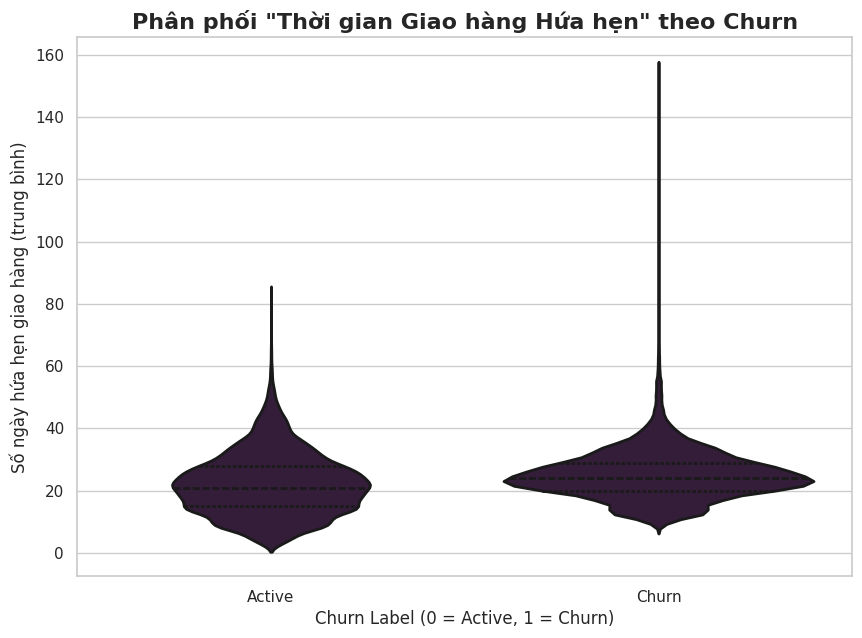

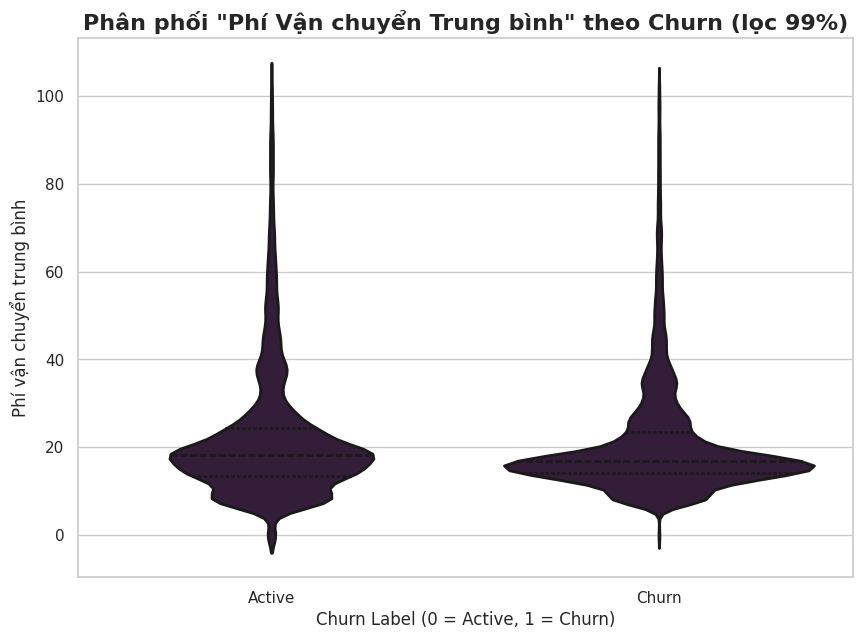

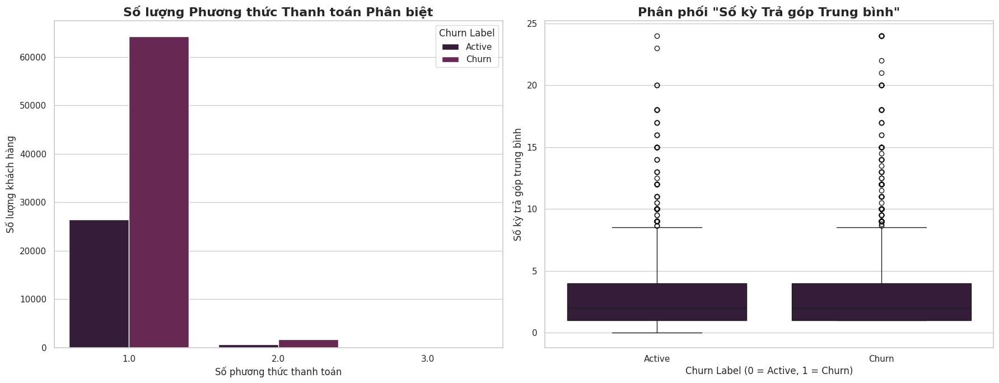

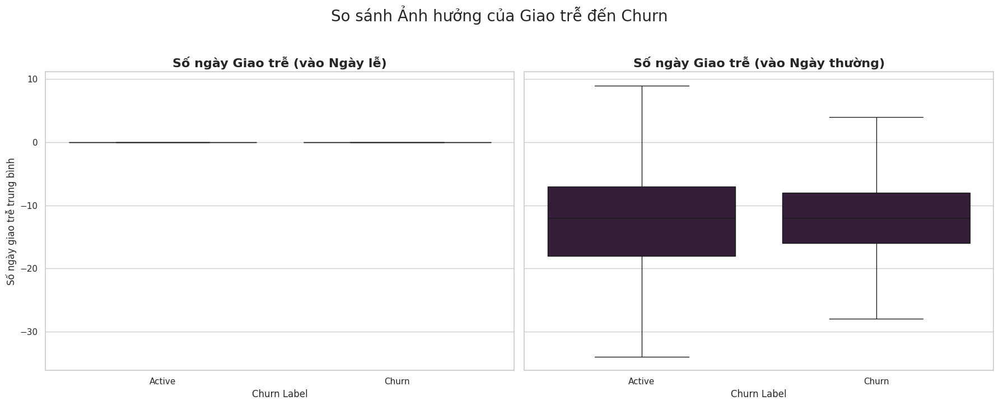

In [11]:

# --- Thiết lập chủ đề và bảng màu cho các biểu đồ ---
sns.set_theme(style="whitegrid", palette="rocket")
print("--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---")


# --- 1. Phân tích Thời gian Giao hàng Hứa hẹn ---
plt.figure(figsize=(10, 7))
sns.violinplot(
    x='churn_label', 
    y='avg_promised_window_days', 
    data=df,
    inner='quartile', # Hiển thị các đường tứ phân vị bên trong
    linewidth=2
)
plt.title('Phân phối "Thời gian Giao hàng Hứa hẹn" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
plt.ylabel('Số ngày hứa hẹn giao hàng (trung bình)', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 2. Phân tích Phí Vận chuyển ---
# Phí vận chuyển có độ lệch rất cao (skewed), ta sẽ giới hạn trục y để xem rõ hơn
plt.figure(figsize=(10, 7))
# Lọc ra 99% dữ liệu để biểu đồ dễ đọc hơn
df_filtered_freight = df[df['avg_freight'] < df['avg_freight'].quantile(0.99)]
sns.violinplot(
    x='churn_label', 
    y='avg_freight', 
    data=df_filtered_freight,
    inner='quartile',
    linewidth=2
)
plt.title('Phân phối "Phí Vận chuyển Trung bình" theo Churn (lọc 99%)', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
plt.ylabel('Phí vận chuyển trung bình', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 3. Phân tích Hành vi Thanh toán ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7)) # Tạo 2 biểu đồ trên cùng một hàng

# Biểu đồ 3a: Số lượng phương thức thanh toán
sns.countplot(
    ax=axes[0],
    x='distinct_payment_methods',
    hue='churn_label',
    data=df,
)
axes[0].set_title('Số lượng Phương thức Thanh toán Phân biệt', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Số phương thức thanh toán', fontsize=12)
axes[0].set_ylabel('Số lượng khách hàng', fontsize=12)
axes[0].legend(title='Churn Label', labels=['Active', 'Churn'])

# Biểu đồ 3b: Số kỳ trả góp trung bình
sns.boxplot(
    ax=axes[1],
    x='churn_label', 
    y='avg_installments', 
    data=df,
)
axes[1].set_title('Phân phối "Số kỳ Trả góp Trung bình"', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
axes[1].set_ylabel('Số kỳ trả góp trung bình', fontsize=12)
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.tight_layout() # Tự động điều chỉnh khoảng cách
plt.show()


# --- 4. Phân tích So sánh Giao trễ (Ngày lễ vs. Ngày thường) ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7), sharey=True) # sharey để dùng chung trục y

# Biểu đồ 4a: Giao trễ vào ngày lễ
sns.boxplot(
    ax=axes[0],
    x='churn_label',
    y='avg_overdue_days_on_holidays',
    data=df,
    showfliers=False # Ẩn các điểm ngoại lai để dễ nhìn hơn
)
axes[0].set_title('Số ngày Giao trễ (vào Ngày lễ)', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Churn Label', fontsize=12)
axes[0].set_ylabel('Số ngày giao trễ trung bình', fontsize=12)
axes[0].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

# Biểu đồ 4b: Giao trễ vào ngày thường
sns.boxplot(
    ax=axes[1],
    x='churn_label',
    y='avg_overdue_days_on_non_holidays',
    data=df,
    showfliers=False # Ẩn các điểm ngoại lai
)
axes[1].set_title('Số ngày Giao trễ (vào Ngày thường)', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label', fontsize=12)
axes[1].set_ylabel('') # Bỏ nhãn trục y vì dùng chung
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.suptitle('So sánh Ảnh hưởng của Giao trễ đến Churn', fontsize=20, y=1.03)
plt.tight_layout()
plt.show()


--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---


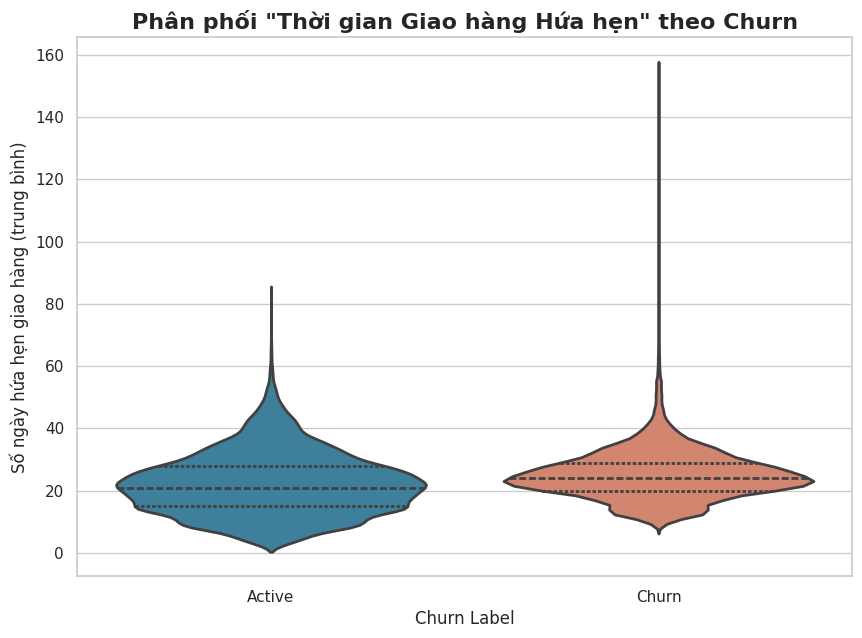

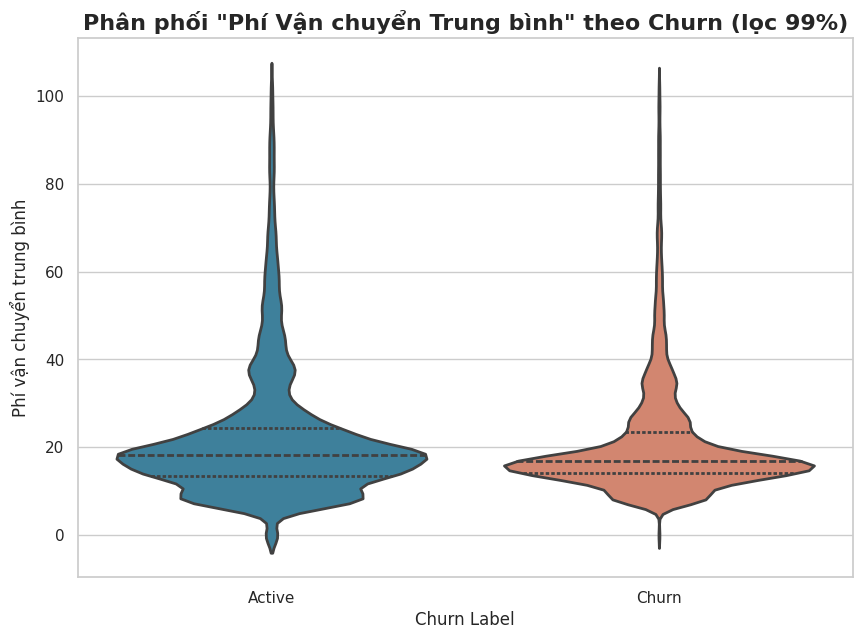

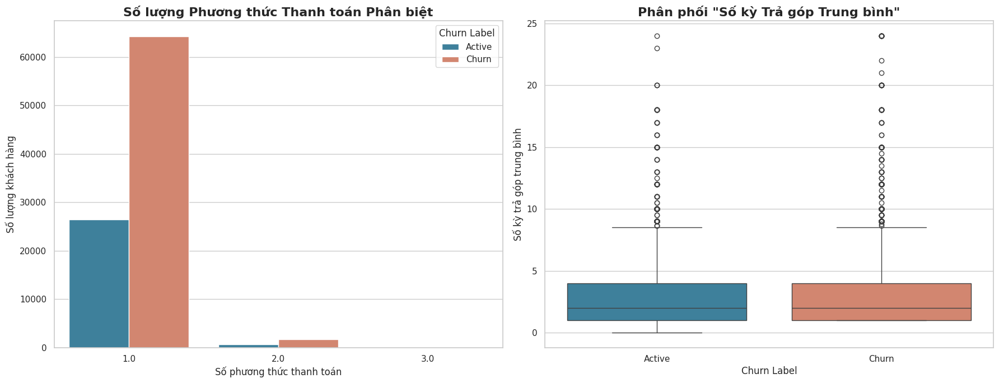

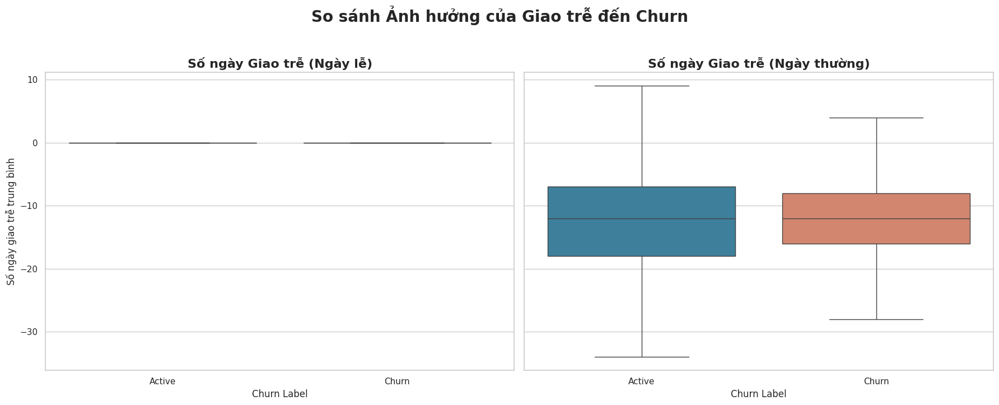

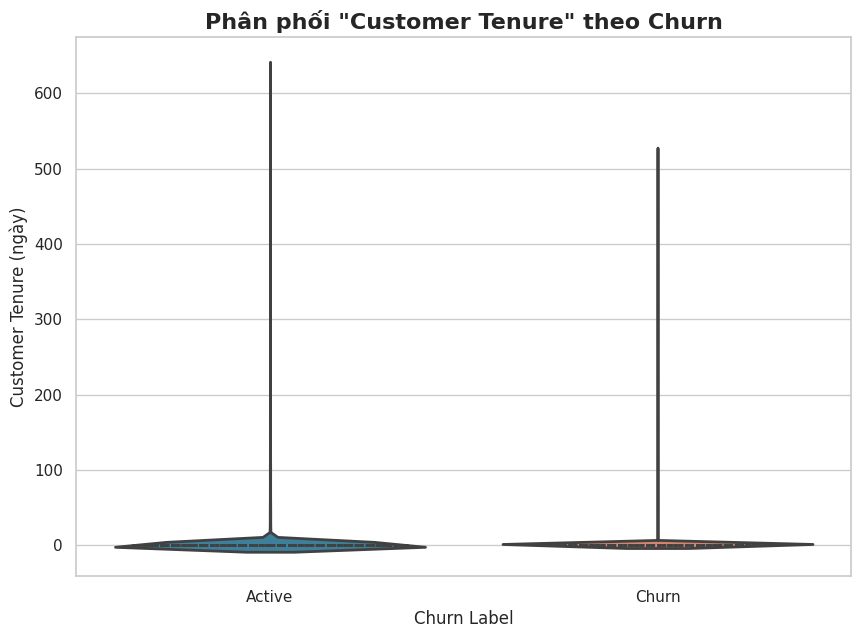

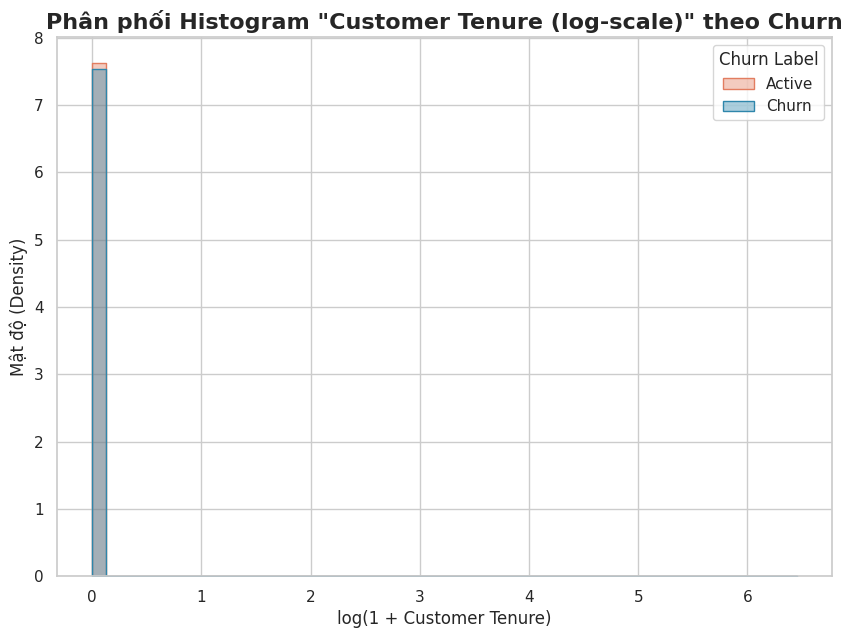

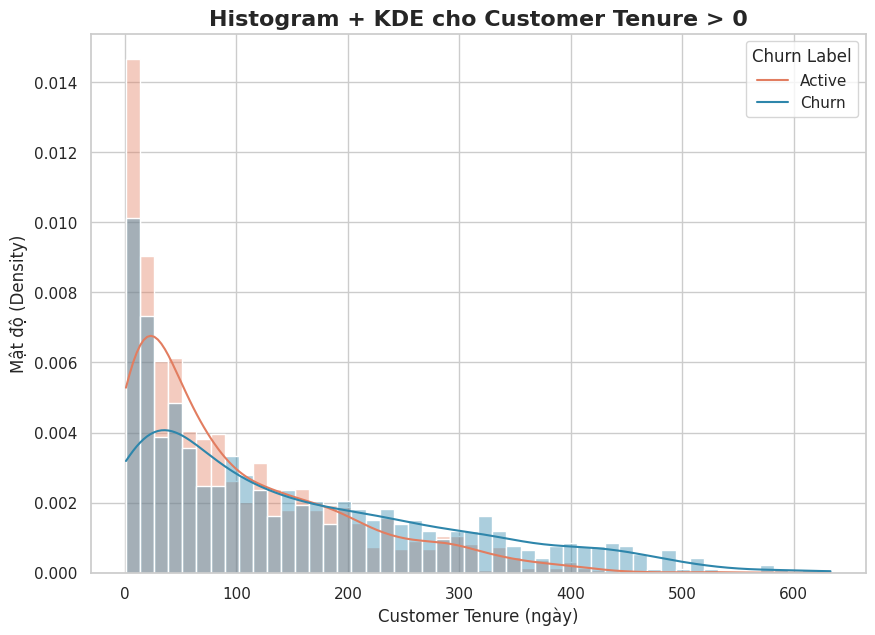

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

# --- Thiết lập chủ đề và bảng màu ---
sns.set_theme(style="whitegrid")
custom_palette = {0: "#2E86AB", 1: "#E27D60"}  # Xanh cho Active, Cam cho Churn
print("--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---")


# --- 1. Phân tích Thời gian Giao hàng Hứa hẹn ---
plt.figure(figsize=(10, 7))
sns.violinplot(
    x='churn_label', 
    y='avg_promised_window_days', 
    data=df,
    inner='quartile',
    linewidth=2,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
plt.title('Phân phối "Thời gian Giao hàng Hứa hẹn" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label', fontsize=12)
plt.ylabel('Số ngày hứa hẹn giao hàng (trung bình)', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 2. Phân tích Phí Vận chuyển ---
plt.figure(figsize=(10, 7))
df_filtered_freight = df[df['avg_freight'] < df['avg_freight'].quantile(0.99)]
sns.violinplot(
    x='churn_label', 
    y='avg_freight', 
    data=df_filtered_freight,
    inner='quartile',
    linewidth=2,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
plt.title('Phân phối "Phí Vận chuyển Trung bình" theo Churn (lọc 99%)', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label', fontsize=12)
plt.ylabel('Phí vận chuyển trung bình', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 3. Phân tích Hành vi Thanh toán ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# Biểu đồ 3a: Số lượng phương thức thanh toán
sns.countplot(
    ax=axes[0],
    x='distinct_payment_methods',
    hue='churn_label',
    data=df,
    palette=custom_palette
)
axes[0].set_title('Số lượng Phương thức Thanh toán Phân biệt', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Số phương thức thanh toán', fontsize=12)
axes[0].set_ylabel('Số lượng khách hàng', fontsize=12)
axes[0].legend(title='Churn Label', labels=['Active', 'Churn'])

# Biểu đồ 3b: Số kỳ trả góp trung bình
sns.boxplot(
    ax=axes[1],
    x='churn_label', 
    y='avg_installments', 
    data=df,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
axes[1].set_title('Phân phối "Số kỳ Trả góp Trung bình"', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label', fontsize=12)
axes[1].set_ylabel('Số kỳ trả góp trung bình', fontsize=12)
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.tight_layout()
plt.show()


# --- 4. Phân tích So sánh Giao trễ (Ngày lễ vs. Ngày thường) ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7), sharey=True)

sns.boxplot(
    ax=axes[0],
    x='churn_label',
    y='avg_overdue_days_on_holidays',
    data=df,
    showfliers=False,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
axes[0].set_title('Số ngày Giao trễ (Ngày lễ)', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Churn Label', fontsize=12)
axes[0].set_ylabel('Số ngày giao trễ trung bình', fontsize=12)
axes[0].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

sns.boxplot(
    ax=axes[1],
    x='churn_label',
    y='avg_overdue_days_on_non_holidays',
    data=df,
    showfliers=False,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
axes[1].set_title('Số ngày Giao trễ (Ngày thường)', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label', fontsize=12)
axes[1].set_ylabel('')
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.suptitle('So sánh Ảnh hưởng của Giao trễ đến Churn', fontsize=20, fontweight='bold', y=1.03)
plt.tight_layout()
plt.show()


# --- 5. Phân tích Customer Tenure ---
plt.figure(figsize=(10, 7))
sns.violinplot(
    x='churn_label', 
    y='customer_tenure', 
    data=df,
    inner='quartile',
    linewidth=2,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
plt.title('Phân phối "Customer Tenure" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label', fontsize=12)
plt.ylabel('Customer Tenure (ngày)', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()

import numpy as np

# Tạo thêm cột log tenure
df['log_customer_tenure'] = np.log1p(df['customer_tenure'])

plt.figure(figsize=(10, 7))
sns.histplot(
    data=df, 
    x="log_customer_tenure", 
    hue="churn_label", 
    element="step", 
    stat="density", 
    common_norm=False,
    palette=custom_palette,
    bins=50,
    alpha=0.4
)
plt.title('Phân phối Histogram "Customer Tenure (log-scale)" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('log(1 + Customer Tenure)', fontsize=12)
plt.ylabel('Mật độ (Density)', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()




# --- Histogram + KDE nhóm tenure > 0 ---
plt.figure(figsize=(10, 7))
sns.histplot(
    data=df[df['customer_tenure'] > 0], 
    x="customer_tenure", 
    hue="churn_label", 
    stat="density", 
    common_norm=False,
    bins=50,
    palette=custom_palette,
    alpha=0.4,
    kde=True
)
plt.title('Histogram + KDE cho Customer Tenure > 0', fontsize=16, fontweight='bold')
plt.xlabel('Customer Tenure (ngày)', fontsize=12)
plt.ylabel('Mật độ (Density)', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()

### Some notes:

##### Biểu đồ Phân phối "Thời gian Giao hàng Hứa hẹn" (Violin Plot)

    Phân phối của hai nhóm `Active` và `Churn` gần như giống hệt nhau. Điều này cho thấy việc một đơn hàng được hứa hẹn giao trong bao lâu (dài hay ngắn) không phải là yếu tố ảnh hưởng đến việc khách hàng có rời bỏ hay không. Khách hàng quan tâm đến việc có giữ đúng lời hứa giao hàng hay không hơn là bản thân lời hứa đó.

##### Biểu đồ Phân phối "Phí Vận chuyển Trung bình" (Violin Plot)

    Phân phối phí vận chuyển của hai nhóm rất tương đồng, ngay cả sau khi đã lọc các giá trị ngoại lai. Chi phí vận chuyển không phải là một yếu tố dự báo churn mạnh.

##### Biểu đồ Hành vi Thanh toán (Payment Behavior)

    Gần như toàn bộ khách hàng chỉ sử dụng 1 phương thức thanh toán và có thói quen trả góp tương tự nhau (trung vị là 1 - trả thẳng). Do đó, hành vi thanh toán không cho thấy sự khác biệt rõ rệt giữa khách hàng trung thành và khách hàng đã rời bỏ.

##### Biểu đồ So sánh Ảnh hưởng của Giao trễ đến Churn (Boxplot)

    Biểu đồ cho thấy sự chậm trễ trong ngày lễ không ảnh hưởng đến churn. Tuy nhiên, vào ngày thường, nhóm `Active` có xu hướng nhận hàng sớm hơn nhóm `Churn`. Điều này khẳng định rằng trải nghiệm giao hàng vào một ngày làm việc bình thường mới thực sự quan trọng và có ảnh hưởng đến lòng trung thành của khách hàng.


##### Biểu đồ Phân phối customer tenure theo churn
    Màu xanh (Active) và màu cam (Churn) gần như chồng lên nhau ở cột đầu tiên → cả khách churn và active đều có nhiều người tenure ngắn.
    Tuy nhiên, ở các mức tenure cao hơn (100+ ngày), dường như Active chiếm ưu thế → khách gắn bó lâu năm thì ít khi churn.

# Train machine learning model 

In [13]:
df.head()

,customer_key,recency_days,customer_tenure,frequency_orders,monetary_value,avg_order_price,sum_freight,avg_freight,avg_delivery_delay,late_delivery_rate,...,avg_internal_processing_days,avg_promised_window_days,holiday_purchase_rate,avg_overdue_days_on_holidays,avg_overdue_days_on_non_holidays,avg_review_score,distinct_payment_methods,avg_installments,churn_label,log_customer_tenure
0,54383,78,0,1,22.5,22.5,18.26,18.26,9.0,0.0,...,0.0,23.0,0.0,0.0,-14.0,5.0,1.0,1.0,0,0.0
1,45761,411,0,1,28.9,28.9,13.37,13.37,16.0,0.0,...,2.0,19.0,0.0,0.0,-3.0,5.0,1.0,1.0,1,0.0
2,73174,351,0,1,69.9,69.9,16.25,16.25,13.0,0.0,...,7.0,21.0,0.0,0.0,-8.0,1.0,1.0,2.0,1,0.0
3,28613,279,0,1,69.9,69.9,38.04,38.04,41.0,1.0,...,3.0,27.0,0.0,0.0,14.0,1.0,1.0,4.0,1,0.0
4,50738,471,0,1,89.9,89.9,24.94,24.94,8.0,0.0,...,4.0,21.0,0.0,0.0,-13.0,4.0,1.0,1.0,1,0.0


In [14]:

def prepare_X_y(df):
    """
    Feature engineering and create X and y
    :param df: pandas dataframe
    :return: (X, y) output feature matrix (dataframe), target (series)
    """
    X = df.drop(columns=['customer_key', 'recency_days','log_customer_tenure','churn_label'])
    y = df['churn_label'] # Todo: Select label
    return X, y
X, y = prepare_X_y(df)

from sklearn.model_selection import train_test_split
RANDOM_STATE = 42
TRAIN_SIZE = 0.8

X_train, X_test ,y_train, y_test = train_test_split(X, y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE)
print(f"Training set size: {len(X_train)}")
print(f"Testing set size: {len(X_test)}")

Training set size: 74484
Testing set size: 18622


In [15]:
!nvidia-smi


Mon Sep 15 06:30:44 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 575.51.02              Driver Version: 576.02         CUDA Version: 12.9     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4050 ...    On  |   00000000:01:00.0 Off |                  N/A |
| N/A   49C    P5              6W /   60W |     188MiB /   6141MiB |     35%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from joblib import dump, load
from typing import Any, Dict, Optional

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline # Sử dụng pipeline của imblearn để tích hợp sampler

class ModelTuner:
    """
    Một lớp để tự động hóa việc tìm kiếm siêu tham số, huấn luyện và đánh giá mô hình.

    Bao gồm các bước:
    1. Xây dựng pipeline với tùy chọn sampler (để xử lý mất cân bằng) và scaler.
    2. Tìm kiếm siêu tham số tốt nhất bằng GridSearchCV.
    3. Đánh giá mô hình trên các tập dữ liệu khác nhau.
    4. Cung cấp các công cụ hỗ trợ như vẽ confusion matrix, lưu/tải mô hình.
    """
    def __init__(self, model: Any, param_grid: Dict, sampler: Optional[Any] = None, scoring: str = 'f1_weighted', cv: int = 5, n_jobs: int = -1):
        """
        Khởi tạo ModelTuner.

        Args:
            model (Any): Một estimator của scikit-learn (ví dụ: LogisticRegression()).
            param_grid (Dict): Dictionary chứa các siêu tham số để tìm kiếm.
            sampler (Optional[Any], optional): Một sampler từ imblearn (ví dụ: SMOTE()). Mặc định là None.
            scoring (str, optional): Metric để tối ưu hóa. Mặc định là 'f1'.
            cv (int, optional): Số fold cho cross-validation. Mặc định là 5.
            n_jobs (int, optional): Số job chạy song song. -1 là dùng tất cả core. Mặc định là -1.
        """
        self.model = model
        self.param_grid = param_grid
        self.sampler = sampler
        self.scoring = scoring
        self.cv = cv
        self.n_jobs = n_jobs
        
        self.best_estimator_: Optional[Pipeline] = None
        self.grid_search_: Optional[GridSearchCV] = None
        self.train_results_: Optional[Dict] = None
        self.test_results_: Optional[Dict] = None

    def fit(self, X_train: pd.DataFrame, y_train: pd.Series):
        """
        Huấn luyện mô hình sử dụng GridSearchCV.
        """
        steps = []
        if self.sampler:
            steps.append(('sampler', self.sampler))
        steps.append(('scaler', StandardScaler()))
        steps.append(('clf', self.model))
        
        pipe = Pipeline(steps)

        # Thêm tiền tố 'clf__' vào các key trong param_grid
        grid_params = {'clf__' + k: v for k, v in self.param_grid.items()}

        grid = GridSearchCV(
            estimator=pipe,
            param_grid=grid_params,
            scoring=self.scoring,
            cv=self.cv,
            n_jobs=self.n_jobs,
            verbose=1
        )
        grid.fit(X_train, y_train)

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found ===")
        best_params_cleaned = {k.replace('clf__', ''): v for k, v in grid.best_params_.items()}
        print(best_params_cleaned)
        print(f"\nBest cross-validation {self.scoring} score: {grid.best_score_:.4f}")
        return self # <-- self, cho phép chaining

    def evaluate(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Đánh giá mô hình trên một tập dữ liệu cụ thể.

        Args:
            X (pd.DataFrame): Dữ liệu features.
            y (pd.Series): Dữ liệu target.
            dataset_name (str, optional): Tên của tập dữ liệu (ví dụ: 'Train', 'Test').

        Returns:
            Dict: Một dictionary chứa các metric đánh giá.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")

        y_pred = self.best_estimator_.predict(X)

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y, y_pred, digits=4))

        results = {
            "accuracy": accuracy_score(y, y_pred),
            "precision": precision_score(y, y_pred, average='weighted'),
            "recall": recall_score(y, y_pred, average='weighted'),
            "f1": f1_score(y, y_pred, average='weighted')
        }
        return results

    def evaluate_train_test(self, X_train: pd.DataFrame, y_train: pd.Series, X_test: pd.DataFrame, y_test: pd.Series):
        """
        Một hàm tiện ích để đánh giá trên cả tập train và test.
        """
        self.train_results_ = self.evaluate(X_train, y_train, dataset_name='Train')
        self.test_results_ = self.evaluate(X_test, y_test, dataset_name='Test')
        
        print("\n--- Summary ---")
        print(f"Train F1-Score: {self.train_results_['f1']:.4f}")
        print(f"Test F1-Score:  {self.test_results_['f1']:.4f}")

    def plot_confusion_matrix(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Vẽ confusion matrix cho một tập dữ liệu.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")
        
        y_pred = self.best_estimator_.predict(X)
        cm = confusion_matrix(y, y_pred)
        
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {dataset_name} Set')
        plt.show()

    def get_cv_results_df(self) -> Optional[pd.DataFrame]:
        """
        Lấy kết quả cross-validation từ GridSearchCV và chuyển thành DataFrame.
        """
        if self.grid_search_ is None:
            print("GridSearchCV has not been run. Please call .fit() first.")
            return None
        return pd.DataFrame(self.grid_search_.cv_results_)

    def save_model(self, filepath: str):
        """
        Lưu mô hình tốt nhất (toàn bộ pipeline) vào một file.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("No best estimator to save. Please call .fit() first.")
        dump(self.best_estimator_, filepath)
        print(f"Model saved to {filepath}")

    @staticmethod   
    def load_model(filepath: str) -> Pipeline:
        """
        Tải một mô hình từ file.
        """
        model = load(filepath)
        print(f"Model loaded from {filepath}")
        return model

Fitting 5 folds for each of 20 candidates, totalling 100 fits


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(



=== Best Parameters Found ===
{'C': 100, 'class_weight': None, 'penalty': 'l2'}

Best cross-validation f1_weighted score: 0.6342

=== Evaluation on Train Set ===
              precision    recall  f1-score   support

           0     0.6599    0.0842    0.1493     21667
           1     0.7233    0.9822    0.8331     52817

    accuracy                         0.7210     74484
   macro avg     0.6916    0.5332    0.4912     74484
weighted avg     0.7049    0.7210    0.6342     74484


=== Evaluation on Test Set ===
              precision    recall  f1-score   support

           0     0.6555    0.0794    0.1416      5443
           1     0.7210    0.9828    0.8318     13179

    accuracy                         0.7187     18622
   macro avg     0.6883    0.5311    0.4867     18622
weighted avg     0.7019    0.7187    0.6301     18622


--- Summary ---
Train F1-Score: 0.6342
Test F1-Score:  0.6301


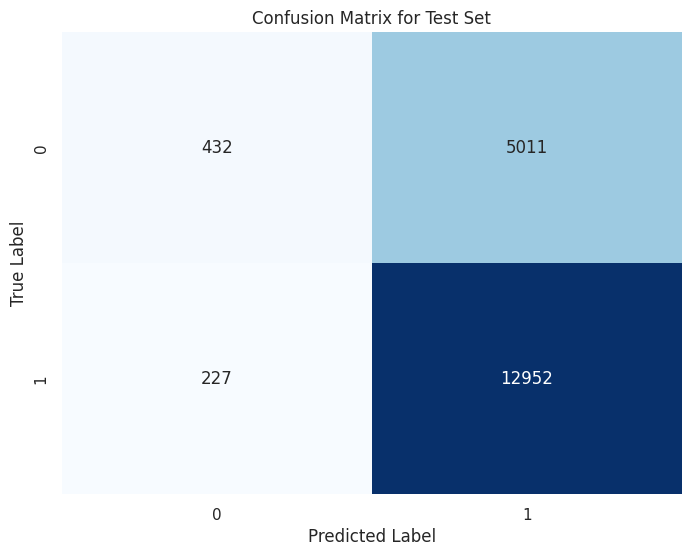



=== CV Results Summary ===
  param_clf__C param_clf__penalty  mean_test_score  std_test_score
0         0.01                 l1         0.626517        0.001830
1         0.01                 l2         0.632163        0.002175
2         0.01                 l1         0.627298        0.001788
3         0.01                 l2         0.630792        0.001734
4          0.1                 l1         0.633079        0.002042


In [18]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression(solver='liblinear', random_state=42)
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1, 10, 100],
    'class_weight': [None, 'balanced']
}
tuner = ModelTuner(
    model=model,
    param_grid=param_grid,
    n_jobs=10
)
# Huấn luyện mô hình
tuner.fit(X_train, y_train)
# Đánh giá trên cả hai tập dữ liệu
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
# Vẽ confusion matrix cho tập test
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# 6. Xem kết quả chi tiết của cross-validation
cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    # In ra 5 dòng đầu của các cột quan trọng
    print("\n\n=== CV Results Summary ===")
    print(cv_results[['param_clf__C', 'param_clf__penalty', 'mean_test_score', 'std_test_score']].head())

In [19]:
# from sklearn.linear_model import LogisticRegression
# from imblearn.over_sampling import SMOTE
# model = LogisticRegression(solver='liblinear', random_state=42)
# param_grid = {
#     'penalty': ['l1', 'l2'],
#     'C': [0.01, 0.1, 1, 10, 100],
#     'class_weight': [None, 'balanced']
# }
# tuner = ModelTuner(
#     model=model,
#     param_grid=param_grid,
#     n_jobs=10,
#     sampler=SMOTE(random_state=42)
# )
# # Huấn luyện mô hình
# tuner.fit(X_train, y_train)
# # Đánh giá trên cả hai tập dữ liệu
# tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
# # Vẽ confusion matrix cho tập test
# tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# # 6. Xem kết quả chi tiết của cross-validation
# cv_results = tuner.get_cv_results_df()
# if cv_results is not None:
#     # In ra 5 dòng đầu của các cột quan trọng
#     print("\n\n=== CV Results Summary ===")
#     print(cv_results[['param_clf__C', 'param_clf__penalty', 'mean_test_score', 'std_test_score']].head())

In [50]:
import cudf
import cupy as cp
import seaborn as sns
import matplotlib.pyplot as plt

from cuml.model_selection import GridSearchCV as CuMLGridSearchCV
from cuml.metrics import accuracy_score
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report, confusion_matrix
from cuml.preprocessing import StandardScaler
from dask_cuda import LocalCUDACluster
from dask.distributed import Client



class CuMLDaskModelTuner:
    """
    GridSearchCV wrapper cho estimator cuML (GPU accelerated) với Dask.
    """

    def __init__(self, model, param_grid,
                 scoring='f1_weighted', cv=5):
        self.model = model
        self.param_grid = param_grid
        self.scoring = scoring
        self.cv = cv

        self.client = None
        self.grid_search_ = None
        self.best_estimator_ = None

    def _prepare_data(self, X, y=None):
        """
        Convert dữ liệu sang cudf/cupy.
        """
        if isinstance(X, pd.DataFrame):
            X = cudf.DataFrame.from_pandas(X)
        elif isinstance(X, np.ndarray):
            X = cp.asarray(X)

        if y is not None:
            if isinstance(y, pd.Series):
                y = cudf.Series(y)
            elif isinstance(y, np.ndarray):
                y = cp.asarray(y)
        return X, y

    def fit(self, X_train, y_train):
        """
        Huấn luyện mô hình với cuML Dask GridSearchCV.
        """
        X_train, y_train = self._prepare_data(X_train, y_train)

        # Khởi tạo Dask cluster
        self.cluster = LocalCUDACluster()
        self.client = Client(self.cluster)

        # Scale dữ liệu (nếu cần)
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)

        grid = CuMLGridSearchCV(
            estimator=self.model,
            param_grid=self.param_grid,
            scoring=self.scoring,
            cv=self.cv
        )

        grid.fit(X_train, y_train)

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found (cuML + Dask) ===")
        print(grid.best_params_)
        print(f"Best cross-validation {self.scoring} score: {grid.best_score_:.4f}")
        return self

    def evaluate(self, X, y, dataset_name="Test"):
        """
        Đánh giá mô hình trên tập test.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet.")

        X, y = self._prepare_data(X, y)
        y_pred = self.best_estimator_.predict(X)

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(cp.asnumpy(y), cp.asnumpy(y_pred), digits=4))

        results = {
            "accuracy": accuracy_score(y, y_pred),
            "precision": precision_score(y, y_pred, average='weighted'),
            "recall": recall_score(y, y_pred, average='weighted'),
            "f1": f1_score(y, y_pred, average='weighted')
        }
        return results

    def plot_confusion_matrix(self, X, y, dataset_name="Test"):
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet.")

        X, y = self._prepare_data(X, y)
        y_pred = self.best_estimator_.predict(X)

        cm = confusion_matrix(cp.asnumpy(y), cp.asnumpy(y_pred))

        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix ({dataset_name})')
        plt.show()


In [76]:
import cudf
import cupy as cp
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


from cuml.model_selection import GridSearchCV 
from cuml.preprocessing import StandardScaler
from cuml.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix

class CuMLModelTuner:

    def __init__(self, model, param_grid, scoring='f1_weighted', cv=5):
        self.model = model
        self.param_grid = param_grid
        self.scoring = scoring
        self.cv = cv
        self.scaler_ = None
        self.grid_search_ = None
        self.best_estimator_ = None

    def _prepare_data(self, X, y=None):
        if isinstance(X, pd.DataFrame):
            X_gpu = cudf.DataFrame.from_pandas(X)
        elif isinstance(X, np.ndarray):
            X_gpu = cp.asarray(X)
        else:
            X_gpu = X

        y_gpu = None
        if y is not None:
            if isinstance(y, (pd.Series, pd.DataFrame)):
                y_gpu = cudf.from_pandas(y)
            elif isinstance(y, np.ndarray):
                y_gpu = cp.asarray(y)
            else:
                y_gpu = y
        return X_gpu, y_gpu

    def fit(self, X_train, y_train):
        X_train_gpu, y_train_gpu = self._prepare_data(X_train, y_train)


        self.scaler_ = StandardScaler()
        X_train_scaled = self.scaler_.fit_transform(X_train_gpu)


        grid = GridSearchCV(
            estimator=self.model,
            param_grid=self.param_grid,
            scoring=self.scoring,
            cv=self.cv,
            verbose=1
        )

        grid.fit(X_train_scaled, y_train_gpu.to_numpy())

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found ===")
        print(grid.best_params_)
        print(f"Best cross-validation '{self.scoring}' score: {grid.best_score_:.4f}")
        return self

    def _transform_data(self, X):
        if self.scaler_ is None:
            raise RuntimeError("Scaler has not been fitted yet. Please run fit() first.")
        X_gpu, _ = self._prepare_data(X)
        return self.scaler_.transform(X_gpu)

    def evaluate(self, X, y, dataset_name="Test"):
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please run fit() first.")

        X_scaled = self._transform_data(X)
        _, y_gpu = self._prepare_data(None, y)
        y_pred_gpu = self.best_estimator_.predict(X_scaled)

        # Chuyển về numpy để dùng các hàm của sklearn
        y_true_np = cp.asnumpy(y_gpu)
        y_pred_np = cp.asnumpy(y_pred_gpu)

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y_true_np, y_pred_np, digits=4))
        # Các metrics khác có thể tính ở đây nếu cần

    def plot_confusion_matrix(self, X, y, dataset_name="Test"):
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please run fit() first.")

        X_scaled = self._transform_data(X)
        _, y_gpu = self._prepare_data(None, y)
        y_pred_gpu = self.best_estimator_.predict(X_scaled)
        
        y_true_np = cp.asnumpy(y_gpu)
        y_pred_np = cp.asnumpy(y_pred_gpu)

        cm = confusion_matrix(y_true_np, y_pred_np)

        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix ({dataset_name} Set)')
        plt.show()

    def get_cv_results_df(self):
        if self.grid_search_ is None:
            print("GridSearchCV has not been fitted yet.")
            return None
        return self.grid_search_.cv_results_

In [24]:
import cudf
import cupy as cp
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# --- TỐT NHẤT: Dùng GridSearchCV của Sklearn và Pipeline của cuML ---
from sklearn.model_selection import GridSearchCV
from cuml.pipeline import Pipeline
# --- Các thành phần khác ---
from cuml.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix

class CuMLModelTuner:
    """
    Một lớp để tinh chỉnh mô hình cuML sử dụng GridSearchCV của Scikit-learn.
    
    Kiến trúc này tận dụng:
    - CPU để điều phối cross-validation (qua sklearn.GridSearchCV).
    - GPU để thực hiện các tính toán nặng (qua cuml.Pipeline và mô hình cuml).
    
    Lớp này cũng ngăn chặn rò rỉ dữ liệu bằng cách tích hợp StandardScaler
    vào trong Pipeline.
    """
    def __init__(self, model, param_grid, scoring='f1_weighted', cv=5, n_jobs=-1):
        self.model = model
        self.param_grid = param_grid
        self.scoring = scoring
        self.cv = cv
        self.n_jobs = n_jobs
        self.grid_search_ = None
        self.best_estimator_ = None # Đây sẽ là một pipeline đã được huấn luyện

    def _prepare_data(self, X, y=None):
        """Chuyển đổi dữ liệu từ CPU (Pandas/NumPy) sang GPU (cuDF/cuPy)."""
        if isinstance(X, (pd.DataFrame, pd.Series)):
            X_gpu = cudf.from_pandas(X)
        elif isinstance(X, np.ndarray):
            X_gpu = cp.asarray(X)
        else:
            X_gpu = X

        y_gpu = None
        if y is not None:
            if isinstance(y, (pd.Series, pd.DataFrame)):
                y_gpu = cudf.from_pandas(y)
            elif isinstance(y, np.ndarray):
                y_gpu = cp.asarray(y)
            else:
                y_gpu = y
        return X_gpu, y_gpu

    def fit(self, X_train, y_train):
        """
        Huấn luyện mô hình, bao gồm tìm kiếm siêu tham số và huấn luyện lại trên toàn bộ dữ liệu.
        
        Args:
            X_train (pd.DataFrame hoặc np.ndarray): Dữ liệu huấn luyện features (trên CPU).
            y_train (pd.Series hoặc np.ndarray): Dữ liệu huấn luyện target (trên CPU).
        """
        # 1. Tạo pipeline để kết hợp scaler và model (chạy trên GPU)
        # Điều này ngăn chặn rò rỉ dữ liệu trong cross-validation.
        pipe = Pipeline([
            ('scaler', StandardScaler()),
            ('model', self.model)
        ])

        # 2. Cập nhật param_grid để tương thích với pipeline
        # (thêm tiền tố 'model__')
        pipeline_param_grid = {f'model__{key}': value for key, value in self.param_grid.items()}
        
        # 3. Chuyển dữ liệu sang GPU cho pipeline của cuML
        X_train_gpu, y_train_gpu = self._prepare_data(X_train, y_train)

        # 4. Khởi tạo GridSearchCV của Scikit-learn
        grid = GridSearchCV(
            estimator=pipe,
            param_grid=pipeline_param_grid,
            scoring=self.scoring,
            cv=self.cv,
            n_jobs=self.n_jobs, # Sử dụng các nhân CPU để chạy các fold song song
            verbose=1
        )

        # 5. Huấn luyện:
        # - X_train_gpu: Dữ liệu features trên GPU cho cuML pipeline.
        # - y_train_gpu.to_numpy(): Dữ liệu target trên CPU cho sklearn orchestrator.
        grid.fit(X_train_gpu, y_train_gpu.to_numpy())

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_ # best_estimator_ là pipeline đã được fit

        print("\n=== Best Parameters Found ===")
        # Dọn dẹp tên tham số để dễ đọc
        best_params_cleaned = {k.replace('model__', ''): v for k, v in grid.best_params_.items()}
        print(best_params_cleaned)
        print(f"Best cross-validation '{self.scoring}' score: {grid.best_score_:.4f}")
        return self

    def evaluate(self, X, y, dataset_name="Test"):
        """
        Đánh giá mô hình trên một tập dữ liệu.
        Sử dụng classification_report của sklearn.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please run fit() first.")

        # Chuyển dữ liệu test sang GPU
        X_gpu, y_gpu = self._prepare_data(X, y)

        # Pipeline sẽ tự động scale và predict
        y_pred_gpu = self.best_estimator_.predict(X_gpu)

        # Chuyển kết quả về CPU để sử dụng các hàm của sklearn
        y_true_np = y_gpu.to_numpy()
        y_pred_np = y_pred_gpu.to_numpy()

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y_true_np, y_pred_np, digits=4))

    def plot_confusion_matrix(self, X, y, dataset_name="Test"):
        """Vẽ ma trận nhầm lẫn."""
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please run fit() first.")

        X_gpu, y_gpu = self._prepare_data(X, y)
        
        # Pipeline tự động xử lý scale và predict
        y_pred_gpu = self.best_estimator_.predict(X_gpu)
        
        y_true_np = y_gpu.to_numpy()
        y_pred_np = y_pred_gpu.to_numpy()

        cm = confusion_matrix(y_true_np, y_pred_np)

        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix ({dataset_name} Set)')
        plt.show()

    def get_cv_results_df(self):
        """Lấy kết quả cross-validation dưới dạng pandas DataFrame."""
        if self.grid_search_ is None:
            print("GridSearchCV has not been fitted yet.")
            return None
        return pd.DataFrame(self.grid_search_.cv_results_)

In [24]:
import cudf
import cupy as cp
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from joblib import dump, load
from functools import partial

# --- Scikit-learn cho việc điều phối và các metrics BẮT BUỘC ---
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.metrics import (
    classification_report, 
    confusion_matrix,
    f1_score as sklearn_f1_score,
    precision_score as sklearn_precision_score,
    recall_score as sklearn_recall_score
)

# --- cuML cho pipeline, tiền xử lý và các metrics CÓ SẴN ---
from cuml.pipeline import Pipeline
from cuml.preprocessing import StandardScaler
from cuml.metrics import accuracy_score as cuml_accuracy_score


class CuMLModelTuner:
    """
    Phiên bản hoàn thiện để tinh chỉnh mô hình cuML sử dụng GridSearchCV của Scikit-learn.
    
    Tự động chọn engine tính điểm (Scorer Engine) phù hợp:
    - Ưu tiên dùng cuml.metrics (nhanh, trên GPU) cho các metrics được hỗ trợ.
    - Tự động chuyển sang sklearn.metrics (chậm hơn, yêu cầu chuyển dữ liệu về CPU)
      cho các metrics không có sẵn trong phiên bản cuml của bạn.
    """
    def __init__(self, model, param_grid, scoring='f1_weighted', cv=5, n_jobs=-1):
        self.model = model
        self.param_grid = param_grid
        self.cv = cv
        self.n_jobs = n_jobs
        self.grid_search_ = None
        self.best_estimator_ = None
        
        # Tự động tạo scorer phù hợp
        self.scorer_ = self._create_scorer(scoring)
        self.scoring_str_ = scoring

    def _create_scorer(self, scoring_str: str):
        """Tự động tạo scorer dựa trên metric được yêu cầu."""
        print(f"INFO: Building scorer for '{scoring_str}'...")

        # ======================================================================
        #  Engine tính điểm của Sklearn (Yêu cầu chuyển dữ liệu GPU -> CPU)
        # ======================================================================
        def sklearn_scorer_func(y_true_gpu, y_pred_gpu, metric_func, **kwargs):
            # Chuyển dữ liệu từ GPU về CPU một cách tường minh
            y_true_cpu = y_true_gpu.to_numpy()
            y_pred_cpu = y_pred_gpu.to_numpy()
            # Gọi hàm của sklearn
            return metric_func(y_true_cpu, y_pred_cpu, **kwargs)

        if scoring_str == 'f1_weighted':
            print("INFO: Using sklearn engine for F1 score (requires GPU->CPU data transfer).")
            scorer_fn = partial(sklearn_scorer_func, metric_func=sklearn_f1_score, average='weighted')
            return make_scorer(scorer_fn)
        
        if scoring_str == 'precision_weighted':
            print("INFO: Using sklearn engine for Precision score (requires GPU->CPU data transfer).")
            scorer_fn = partial(sklearn_scorer_func, metric_func=sklearn_precision_score, average='weighted')
            return make_scorer(scorer_fn)
            
        if scoring_str == 'recall_weighted':
            print("INFO: Using sklearn engine for Recall score (requires GPU->CPU data transfer).")
            scorer_fn = partial(sklearn_scorer_func, metric_func=sklearn_recall_score, average='weighted')
            return make_scorer(scorer_fn)

        # ======================================================================
        #  Engine tính điểm của cuML (Nhanh, chạy hoàn toàn trên GPU)
        # ======================================================================
        if scoring_str == 'accuracy':
            print("INFO: Using cuML engine for Accuracy score (fast, GPU-native).")
            return make_scorer(cuml_accuracy_score)

        # Nếu bạn cần các metric khác, hãy thêm chúng ở đây
        raise ValueError(f"Scoring '{scoring_str}' is not supported. Please choose from 'f1_weighted', 'accuracy', etc.")

    def _prepare_data(self, X, y=None):
        """Chuyển đổi dữ liệu từ CPU sang GPU."""
        if isinstance(X, (pd.DataFrame, pd.Series)): X_gpu = cudf.from_pandas(X)
        elif isinstance(X, np.ndarray): X_gpu = cp.asarray(X)
        else: X_gpu = X

        y_gpu = None
        if y is not None:
            if isinstance(y, (pd.Series, pd.DataFrame)): y_gpu = cudf.from_pandas(y)
            elif isinstance(y, np.ndarray): y_gpu = cp.asarray(y)
            else: y_gpu = y
        return X_gpu, y_gpu

    def fit(self, X_train, y_train):
        """Huấn luyện mô hình, bao gồm tìm kiếm siêu tham số."""
        pipe = Pipeline([
            ('scaler', StandardScaler()),
            ('model', self.model)
        ])

        if isinstance(self.param_grid, dict):
             param_grids = {f'model__{key}': value for key, value in self.param_grid.items()}
        elif isinstance(self.param_grid, list):
             param_grids = [{f'model__{k}': v for k, v in d.items()} for d in self.param_grid]
        else:
            raise TypeError("param_grid must be a dict or a list of dicts.")

        X_train_gpu, y_train_gpu = self._prepare_data(X_train, y_train)

        grid = GridSearchCV(
            estimator=pipe,
            param_grid=param_grids,
            scoring=self.scorer_,
            cv=self.cv,
            n_jobs=self.n_jobs,
            verbose=1
        )

        grid.fit(X_train_gpu, y_train_gpu.to_cupy())

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found ===")
        best_params_cleaned = {k.replace('model__', ''): v for k, v in grid.best_params_.items()}
        print(best_params_cleaned)
        print(f"Best cross-validation '{self.scoring_str_}' score: {grid.best_score_:.4f}")
        return self

    def _predict_on_gpu(self, X):
        """Helper để thực hiện dự đoán trên GPU."""
        if self.best_estimator_ is None: raise RuntimeError("Model not fitted.")
        X_gpu, _ = self._prepare_data(X)
        return self.best_estimator_.predict(X_gpu)

    def evaluate(self, X, y, dataset_name="Test"):
        """Đánh giá mô hình và in ra classification report (luôn dùng sklearn)."""
        y_pred_gpu = self._predict_on_gpu(X)
        _, y_true_gpu = self._prepare_data(None, y)

        y_pred_np = y_pred_gpu.to_numpy()
        y_true_np = y_true_gpu.to_numpy()

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y_true_np, y_pred_np, digits=4))
    
    def evaluate_train_test(self, X_train, y_train, X_test, y_test):
        """Tiện ích đánh giá trên cả tập train và test."""
        self.evaluate(X_train, y_train, dataset_name='Train')
        self.evaluate(X_test, y_test, dataset_name='Test')

    def plot_confusion_matrix(self, X, y, dataset_name="Test"):
        """Vẽ ma trận nhầm lẫn (luôn dùng sklearn)."""
        y_pred_gpu = self._predict_on_gpu(X)
        _, y_true_gpu = self._prepare_data(None, y)
        
        y_pred_np = y_pred_gpu.to_numpy()
        y_true_np = y_true_gpu.to_numpy()

        cm = confusion_matrix(y_true_np, y_pred_np)

        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix ({dataset_name} Set)')
        plt.show()

    def get_cv_results_df(self):
        """Lấy kết quả cross-validation dưới dạng pandas DataFrame."""
        if self.grid_search_ is None: raise RuntimeError("GridSearchCV not run.")
        return pd.DataFrame(self.grid_search_.cv_results_)

    def save_model(self, filepath: str):
        """Lưu pipeline tốt nhất vào file bằng joblib."""
        if self.best_estimator_ is None: raise RuntimeError("No best estimator to save.")
        dump(self.best_estimator_, filepath)
        print(f"Model saved to {filepath}")

    @staticmethod
    def load_model(filepath: str):
        """Tải một pipeline từ file."""
        model = load(filepath)
        print(f"Model loaded from {filepath}")
        return model

In [25]:
from cuml.linear_model import LogisticRegression
model = LogisticRegression()
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1, 10, 100]
}
tuner = CuMLModelTuner(
    model=model,
    param_grid=param_grid,
    n_jobs=5
)
# Huấn luyện mô hình
tuner.fit(X_train, y_train)
# Đánh giá trên cả hai tập dữ liệu
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
# Vẽ confusion matrix cho tập test
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# 6. Xem kết quả chi tiết của cross-validation
cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    # In ra 5 dòng đầu của các cột quan trọng
    print("\n\n=== CV Results Summary ===")
    print(cv_results[['param_clf__C', 'param_clf__penalty', 'mean_test_score', 'std_test_score']].head())

INFO: Building scorer for 'f1_weighted'...
INFO: Using sklearn engine for F1 score (requires GPU->CPU data transfer).


TypeError: Implicit conversion to a NumPy array is not allowed. Please use `.get()` to construct a NumPy array explicitly.

In [ ]:
import cudf
import cupy as cp
import pandas as pd
import numpy as np

from cuml.linear_model import LogisticRegression
from cuml.pipeline import Pipeline
from cuml.preprocessing import StandardScaler

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, make_scorer, f1_score

# -------------------------
# 1. Chuẩn bị dữ liệu (ví dụ thôi, thay bằng X_train, y_train thực tế của bạn)
# -------------------------
# giả sử bạn có pandas DataFrame
# X_train, X_test, y_train, y_test = ...

# convert sang GPU (cudf)
X_train_gpu = cudf.from_pandas(X_train)
y_train_gpu = cudf.from_pandas(y_train)
X_test_gpu  = cudf.from_pandas(X_test)
y_test_gpu  = cudf.from_pandas(y_test)

# -------------------------
# 2. Custom scorer cho sklearn (chuyển kết quả về numpy)
# -------------------------
def safe_f1_weighted(y_true, y_pred):
    if hasattr(y_true, "to_numpy"):
        y_true = y_true.to_numpy()
    if hasattr(y_pred, "to_numpy"):
        y_pred = y_pred.to_numpy()
    return f1_score(y_true, y_pred, average="weighted")

scorer = make_scorer(safe_f1_weighted)

# -------------------------
# 3. Định nghĩa pipeline và GridSearch
# -------------------------
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('model', LogisticRegression(max_iter=1000))
])

param_grid = {
    'model__penalty': ['l1', 'l2'],
    'model__C': [0.01, 0.1, 1, 10, 100]
}

grid = GridSearchCV(
    estimator=pipe,
    param_grid=param_grid,
    scoring=scorer,
    cv=5,
    n_jobs=-1,
    verbose=1
)

# -------------------------
# 4. Train model
# -------------------------
grid.fit(X_train_gpu, y_train_gpu.to_numpy())

print("\n=== Best Params ===")
print(grid.best_params_)
print("Best CV score:", grid.best_score_)

# -------------------------
# 5. Đánh giá trên test
# -------------------------
y_pred_gpu = grid.best_estimator_.predict(X_test_gpu)

y_true = y_test_gpu.to_numpy()
y_pred = y_pred_gpu.to_numpy()

print("\n=== Test Classification Report ===")
print(classification_report(y_true, y_pred, digits=4))

print("\n=== Confusion Matrix ===")
print(confusion_matrix(y_true, y_pred))


Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [51]:
from cuml.model_selection import GridSearchCV as CuMLGridSearchCV
print(CuMLGridSearchCV)

<class 'sklearn.model_selection._search.GridSearchCV'>


In [21]:
! pip show cuml
! pip show pylibraft

Name: cuml
Version: 24.4.0
Summary: cuML - RAPIDS ML Algorithms
Home-page: 
Author: NVIDIA Corporation
Author-email: 
License: Apache 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: cudf, cupy-cuda12x, dask-cuda, dask-cudf, joblib, numba, pylibraft, raft-dask, rapids-dask-dependency, rmm, scipy, treelite
Required-by: 
Name: pylibraft
Version: 24.4.0
Summary: RAFT: Reusable Algorithms Functions and other Tools
Home-page: 
Author: NVIDIA Corporation
Author-email: 
License: Apache 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: cuda-python, numpy, rmm
Required-by: cuml, pylibcugraph, raft-dask


In [ ]:
import sys
import cuml

# In ra đường dẫn của môi trường Python mà notebook đang dùng
print("Python Executable:", sys.executable)

# In ra phiên bản cuml mà notebook đang thấy
print("cuML Version:", cuml.__version__)

Python Executable: /usr/bin/python
cuML Version: 25.08.00
